<a href="https://colab.research.google.com/github/ihales/saving-face/blob/master/DL_Project_Face_Swapping.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Face Recognition Project

Akhil Jariwala, Isaac Hales, Laurel Hales <br>
CS230 - Deep Learning <br>
v0.2 - 
2020/05/23

## Notebook Overview

This project takes photos, attempts to detect children (ages 15 an younger) in the images, and then swaps each child face with a donor face of the same general age and gender.

This process can be broken down into three main sections:

* Face Detection
* Age and Gender Detection
* Face Swapping

Each section is completed using a network specifically built for the given task.

* Face Detection uses faced (https://github.com/iitzco/faced)
* Age and Gender Detection is currently done using the process described here: https://data-flair.training/blogs/python-project-gender-age-detection/. We plan to reimplement using a network that we built
* Face Swapping is achieved using fsgan (https://github.com/YuvalNirkin/fsgan)

### Import Base Libraries

In [0]:
import os
import cv2
import sys
import random
import shutil
import math
import argparse
from base64 import b64encode
from google.colab.patches import cv2_imshow
from google.colab import drive


In [2]:
# Faced is implemented using tensorflow version 1, so we will use that through the notebook
%tensorflow_version 1.x

#It would be better to do this with a base_drive and then add on the extensions for each 
# forlder instead of going back to the home directory for each one, that won't work for 
# every user

# Face Swapping requires a temporary directory
temp_dir = "/content/temp/"
!mkdir "/content/temp/"

base_dir = "/content/drive/My Drive/CS230Project/"

# Donor Faces (from UTKFace dataset)
donor_dir = base_dir + "UTKFaceChildren/"

# Directory for gender and age detection files
gad_directory = base_dir + "gad/"

# Directory for test photos
test_photo_dir = base_dir + "FaceDetectionTestPhotos/"

# Directory for fsgan
fsgan_dir = base_dir + 'fsgan/'


TensorFlow 1.x selected.


## Setup Code for Each Network

### Faced

In [3]:
!git clone https://github.com/iitzco/faced.git
!pip install /content/faced

Cloning into 'faced'...
remote: Enumerating objects: 138, done.
remote: Total 138 (delta 0), reused 0 (delta 0), pack-reused 138
Receiving objects: 100% (138/138), 87.55 MiB | 28.69 MiB/s, done.
Resolving deltas: 100% (56/56), done.
Processing ./faced
  Created wheel for faced: filename=faced-0.1-cp36-none-any.whl size=27342263 sha256=32b185f7f1a3ccb3a35c76db714568700c301872f158d6a41a9d9d8ad15586cf
  Stored in directory: /tmp/pip-ephem-wheel-cache-ehtqbajw/wheels/d2/91/db/40e518d25911788d34bff1bfa9d6c5a36fbb01947f49dc8cb6
  Created wheel for gast: filename=gast-0.2.2-cp36-none-any.whl size=7540 sha256=b34680b26706ecd0a9db98b6eab579ead850be92ae6fd48d9bd35f153d90dbed
  Stored in directory: /root/.cache/pip/wheels/5c/2e/7e/a1d4d4fcebe6c381f378ce7743a3ced3699feb89bcfbdadadd
Successfully built faced gast
  Found existing installation: gast 0.3.3
    Uninstalling gast-0.3.3:
      Successfully uninstalled gast-0.3.3


### fsgan

Acknowledgements: We thank Dr. Eyal Gruss, [wangchao0899](https://github.com/wangchao0899), [jjandnn](https://github.com/jjandnn), and [zhuhaozh](https://github.com/zhuhaozh) as well as the original author of the fsgan repository for helping with this demo.

Fill out [this form](https://docs.google.com/forms/d/e/1FAIpQLScyyNWoFvyaxxfyaPLnCIAxXgdxLEMwR9Sayjh3JpWseuYlOA/viewform?usp=sf_link),
and after receiving the email, add a shortcut to the FSGAN shared directory to your drive

In [4]:
drive.mount('/content/drive', force_remount=True) # This mounts Google Drive in a way that lets us see linked files.

!pip install opencv-python ffmpeg-python youtube-dl yacs
#should check to see if this exists before making it 
!mkdir -p /content/projects/
%cd /content/projects/
#similarly should check to see if it exists first
!git clone https://github.com/YuvalNirkin/face_detection_dsfd
!git clone https://github.com/YuvalNirkin/fsgan.git

sys.path += ['/usr/local/lib/python3.7/site-packages', '/content/projects']

!mkdir -p /content/data

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive
     |████████████████████████████████| 1.8MB 13.3MB/s 
/content/projects
Cloning into 'face_detection_dsfd'...
remote: Enumerating objects: 10, done.
remote: Counting objects: 100% (10/10), done.
remote: Compressing objects: 100% (8/8), done.
remote: Total 308 (delta 4), reused 7 (delta 2), pack-reused 298
Receiving objects: 100% (308/308), 17.65 MiB | 17.98 MiB/s, done.
Resolving deltas: 100% (116/116), done.
Cloning into 'fsgan'...
remote: Enumerating objec

#### Configure fsgan

In [5]:
from fsgan.inference.swap import FaceSwapping
from fsgan.criterions.vgg_loss import VGGLoss

#@markdown This step should only be done once unless one of the
#@markdown following parameters is changed:

#@markdown ---
weights_dir = fsgan_dir + 'weights'
#@markdown Number of finetune iterations on the source subject:
finetune_iterations = 800 #@param {type:"slider", min:100, max:2000, step:1}
#@markdown If True, the inner part of the mouth will be removed from the segmentation:
seg_remove_mouth = True #@param {type:"boolean"}
#@markdown ---


detection_model = os.path.join(weights_dir, 'v2/WIDERFace_DSFD_RES152.pth')
pose_model = os.path.join(weights_dir, 'shared/hopenet_robust_alpha1.pth')
lms_model = os.path.join(weights_dir, 'v2/hr18_wflw_landmarks.pth')
seg_model = os.path.join(weights_dir, 'v2/celeba_unet_256_1_2_segmentation_v2.pth')
reenactment_model = os.path.join(weights_dir, 'v2/nfv_msrunet_256_1_2_reenactment_v2.1.pth')
completion_model = os.path.join(weights_dir, 'v2/ijbc_msrunet_256_1_2_inpainting_v2.pth')
blending_model = os.path.join(weights_dir, 'v2/ijbc_msrunet_256_1_2_blending_v2.pth')
criterion_id_path = os.path.join(weights_dir, 'v2/vggface2_vgg19_256_1_2_id.pth')
criterion_id = VGGLoss(criterion_id_path)


face_swapping = FaceSwapping(
    detection_model=detection_model, pose_model=pose_model, lms_model=lms_model,
    seg_model=seg_model, reenactment_model=reenactment_model,
    completion_model=completion_model, blending_model=blending_model,
    criterion_id=criterion_id,
    finetune=True, finetune_save=True, finetune_iterations=finetune_iterations,
    seg_remove_mouth=finetune_iterations, batch_size=16, seg_batch_size=48,
    encoder_codec='mp4v')

Downloading: "https://download.pytorch.org/models/resnet152-b121ed2d.pth" to /root/.cache/torch/checkpoints/resnet152-b121ed2d.pth



=> using GPU devices: 0
=> Loading face pose model: "hopenet_robust_alpha1.pth"...
=> Loading face landmarks model: "hr18_wflw_landmarks.pth"...
=> Loading face segmentation model: "celeba_unet_256_1_2_segmentation_v2.pth"...
=> Loading face reenactment model: "nfv_msrunet_256_1_2_reenactment_v2.1.pth"...
=> Loading face completion model: "ijbc_msrunet_256_1_2_inpainting_v2.pth"...
=> Loading face blending model: "ijbc_msrunet_256_1_2_blending_v2.pth"...


#### Function to call fsgan and return a OpenCV image with swaped face

In [0]:
# age_categories = {2:(0,2), 5:(3,5), 10:(6,10), 14:(11,14)}

age_categories = {2:(0,2), 6:(3,6), 12:(7,12), 20:(13,20), 32:(21,32), 43:(33,43), 53:(44,53), 100:(54,100)}

def setup_donor_face(age, gender):
  """ Given and age classification and gender, return a donor face"""
  
  # convert gender encodings
  gender = 1 if gender == "f" else 0
  # age range
  min_age = age_categories[age][0]
  max_age = age_categories[age][1]

  # filter through possible faces
  filenames = os.listdir(donor_dir)

  donor_file = random.choice([x for x in filenames if int(x.split("_")[0]) >= min_age
                             and int(x.split("_")[0]) <= max_age
                             and int(x.split("_")[1]) == gender])
  shutil.copyfile(donor_dir + donor_file, temp_dir + "source_image.jpg")

def swap_face(original_face, age_and_gender):
  """ Given an image, age classification, and gender, replaces the face with a donor face.

  Arguments:
  original_face -- an OpenCV image to use for swapping
  age_and_gender -- a tuple with an integer age classification and a gender ("m" or "f")

  Returns:
  repalcement_image -- an OpenCV image to use as a replacement in the original picture
  """
  age = age_and_gender[0]
  gender = age_and_gender[1]

  # Quit early if not a minor
  if age > 14:
    return original_face


  # Start by saving the image to disk
  target_image_path = temp_dir + "target_image.jpg"
  cv2.imwrite(target_image_path, original_face)
  # Select a source image at random from directory of face donors
  setup_donor_face(age, gender)
  source_image_path = temp_dir + "source_image.jpg"

  # Swap the faces
  finetune = True
  output_tmp_path = '/content/data/output_tmp.mp4'
  face_swapping(source_image_path, target_image_path, output_tmp_path,
                'longest', 'longest', finetune)

  vidcap = cv2.VideoCapture(output_tmp_path)
  success, image = vidcap.read()

  # Remove Temp Files
  os.remove(output_tmp_path)
  os.remove(target_image_path)
  os.remove(source_image_path)
  shutil.rmtree(temp_dir + "target_image/",)
  shutil.rmtree(temp_dir + "source_image/",)


  return image
  

### Age and Gender Detection

In [0]:
# Filenames and data for all the existing models and weights
faceProto="opencv_face_detector.pbtxt"
faceModel="opencv_face_detector_uint8.pb"
ageProto="age_deploy.prototxt"
ageModel="age_net.caffemodel"
genderProto="gender_deploy.prototxt"
genderModel="gender_net.caffemodel"

MODEL_MEAN_VALUES=(78.4263377603, 87.7689143744, 114.895847746)

# List of options for output ages and genders
ageList=[2, 6, 12, 20, 32, 43, 53, 100]
genderList=['m','f']

# Model definitions
faceNet=cv2.dnn.readNet(gad_directory + faceModel, gad_directory + faceProto)
ageNet=cv2.dnn.readNet(gad_directory + ageModel, gad_directory + ageProto)
genderNet=cv2.dnn.readNet(gad_directory + genderModel, gad_directory + genderProto)



In [0]:
def get_age_and_gender(face, padding=20):
  
  blob=cv2.dnn.blobFromImage(face, 1.0, (227,227), MODEL_MEAN_VALUES, swapRB=False)
  genderNet.setInput(blob)
  genderPreds=genderNet.forward()
  gender=genderList[genderPreds[0].argmax()]

  ageNet.setInput(blob)
  agePreds=ageNet.forward()
  age=ageList[agePreds[0].argmax()]

  return (age, gender)


### Initialize FaceDetector

In [9]:
from faced import FaceDetector
face_detector = FaceDetector()
thresh = 0.6

###Test Sample Classifications

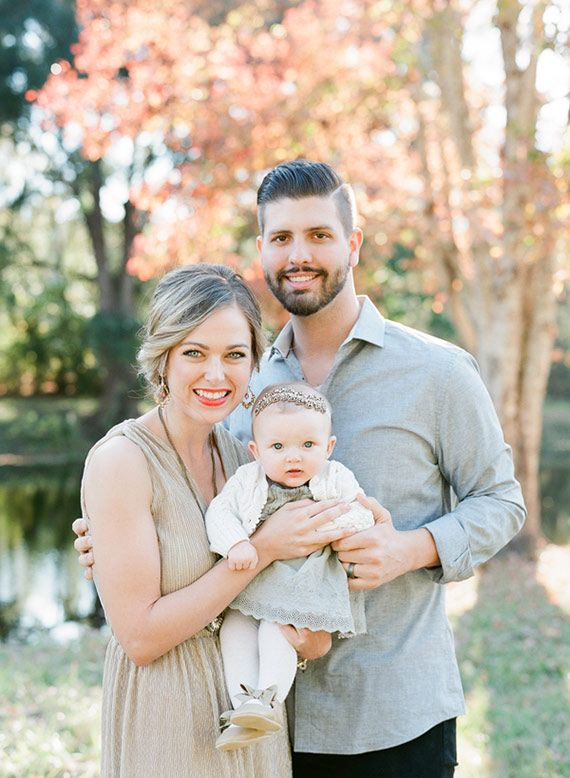

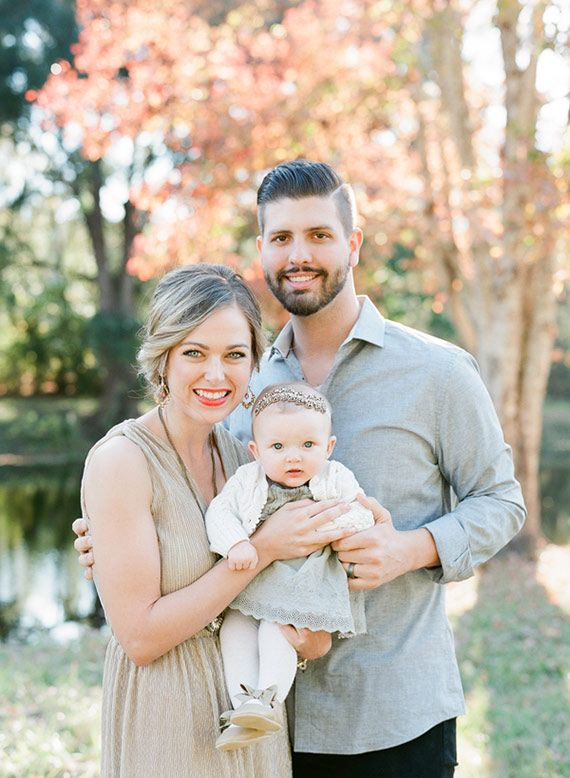

=> Detecting faces in video: "source_image.jpg..."


100%|██████████| 2/2 [00:00<00:00, 332.47it/s]


=> Extracting sequences from detections in video: "source_image.jpg"...
=> Cropping image sequences from image: "source_image.jpg"...
=> Computing face poses for video: "source_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  7.61batches/s]
=> Computing face landmarks for video: "source_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.64batches/s]
=> Computing face segmentation for video: "source_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  4.75batches/s]

  0%|          | 0/1 [00:00<?, ?frames/s]


=> Detecting faces in video: "target_image.jpg..."


100%|██████████| 2/2 [00:00<00:00, 2048.00it/s]

=> Extracting sequences from detections in video: "target_image.jpg"...
=> Cropping image sequences from image: "target_image.jpg"...
=> Computing face poses for video: "target_image_seq00.jpg"...
  0%|          | 0/1 [00:00<?, ?batches/s]

100%|██████████| 1/1 [00:00<00:00,  9.54batches/s]
=> Computing face landmarks for video: "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.45batches/s]
=> Computing face segmentation for video: "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.42batches/s]
=> Face swapping: "source_image_seq00.jpg" -> "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:01<00:00,  1.64s/batches]


100%|██████████| 2/2 [00:00<00:00, 2278.27it/s]

=> Detecting faces in video: "source_image.jpg..."
=> Extracting sequences from detections in video: "source_image.jpg"...
=> Cropping image sequences from image: "source_image.jpg"...
=> Computing face poses for video: "source_image_seq00.jpg"...


100%|██████████| 1/1 [00:00<00:00,  9.98batches/s]
=> Computing face landmarks for video: "source_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  6.11batches/s]
=> Computing face segmentation for video: "source_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.69batches/s]

  0%|          | 0/1 [00:00<?, ?frames/s]


=> Detecting faces in video: "target_image.jpg..."


  0%|          | 0/2 [00:00<?, ?it/s]

=> Extracting sequences from detections in video: "target_image.jpg"...


100%|██████████| 2/2 [00:00<00:00, 1283.64it/s]


=> Cropping image sequences from image: "target_image.jpg"...
=> Computing face poses for video: "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00, 10.13batches/s]
=> Computing face landmarks for video: "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.99batches/s]
=> Computing face segmentation for video: "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.85batches/s]
=> Face swapping: "source_image_seq00.jpg" -> "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:01<00:00,  1.49s/batches]


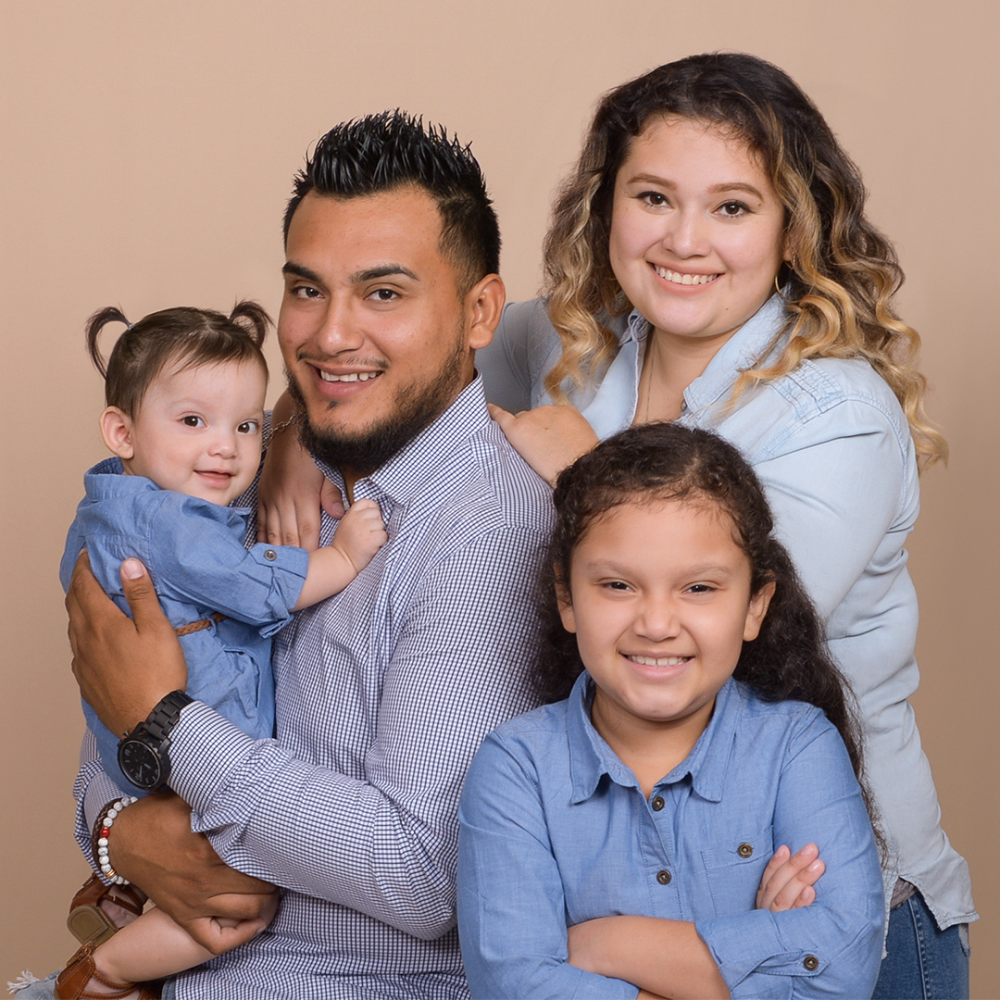

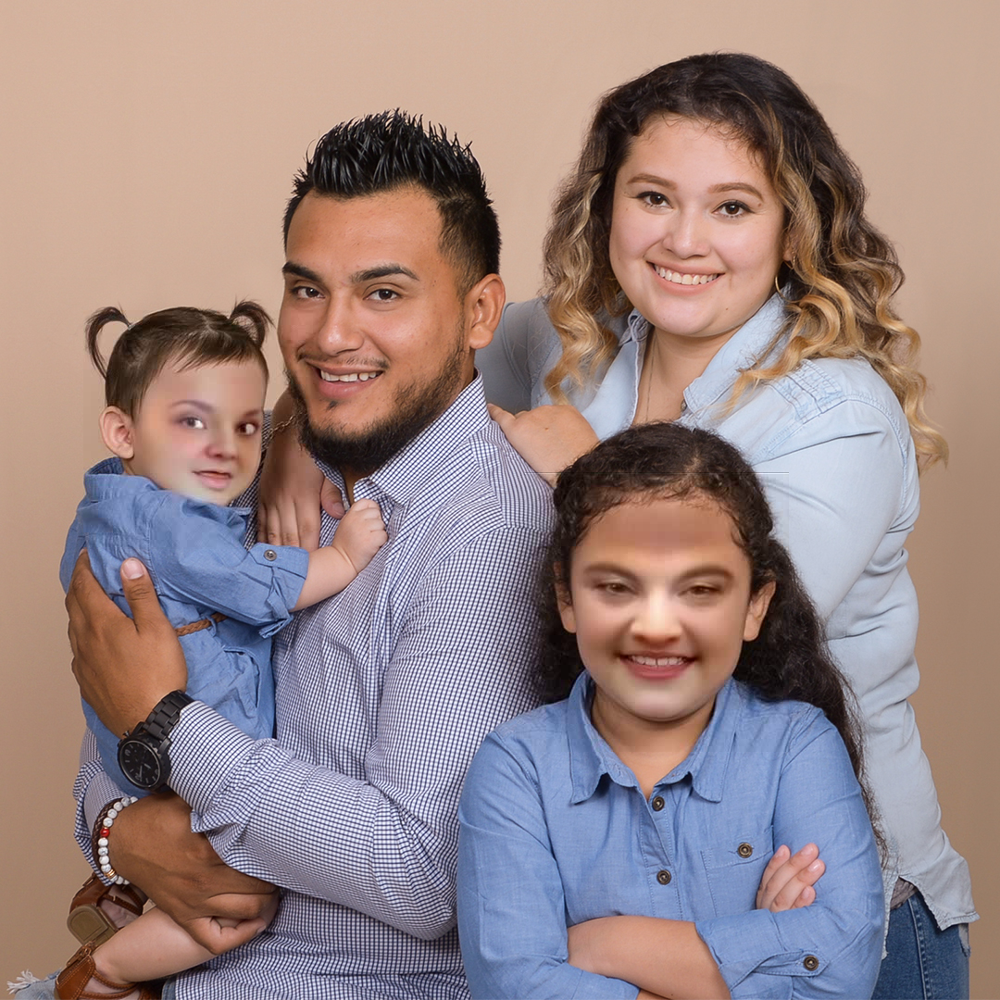

100%|██████████| 2/2 [00:00<00:00, 5038.20it/s]

=> Detecting faces in video: "source_image.jpg..."
=> Extracting sequences from detections in video: "source_image.jpg"...
=> Cropping image sequences from image: "source_image.jpg"...
=> Computing face poses for video: "source_image_seq00.jpg"...


100%|██████████| 1/1 [00:00<00:00,  9.52batches/s]
=> Computing face landmarks for video: "source_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  6.34batches/s]
=> Computing face segmentation for video: "source_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  6.01batches/s]

  0%|          | 0/1 [00:00<?, ?frames/s]


=> Detecting faces in video: "target_image.jpg..."


100%|██████████| 2/2 [00:00<00:00, 4739.33it/s]

=> Extracting sequences from detections in video: "target_image.jpg"...
=> Cropping image sequences from image: "target_image.jpg"...
=> Computing face poses for video: "target_image_seq00.jpg"...


100%|██████████| 1/1 [00:00<00:00, 10.18batches/s]
=> Computing face poses for video: "target_image_seq01.jpg"...
100%|██████████| 1/1 [00:00<00:00, 10.12batches/s]
=> Computing face landmarks for video: "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.71batches/s]
=> Computing face landmarks for video: "target_image_seq01.jpg"...
100%|██████████| 1/1 [00:00<00:00,  6.09batches/s]
=> Computing face segmentation for video: "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  6.10batches/s]
=> Computing face segmentation for video: "target_image_seq01.jpg"...
100%|██████████| 1/1 [00:00<00:00,  6.05batches/s]
=> Face swapping: "source_image_seq00.jpg" -> "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:01<00:00,  1.46s/batches]


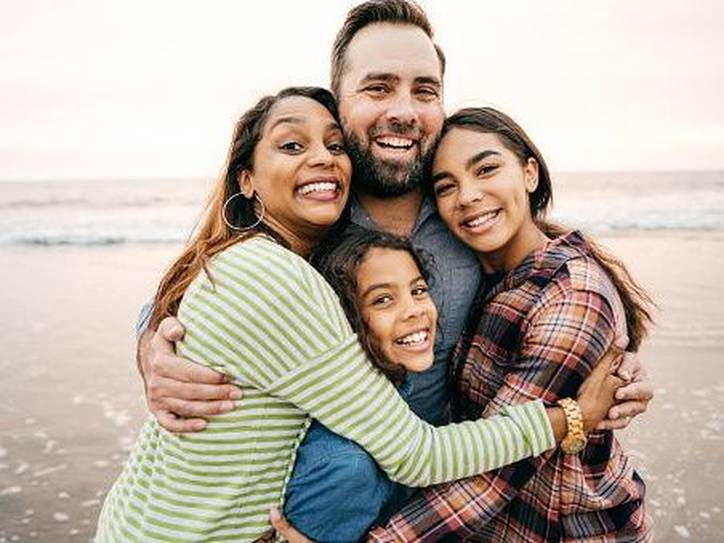

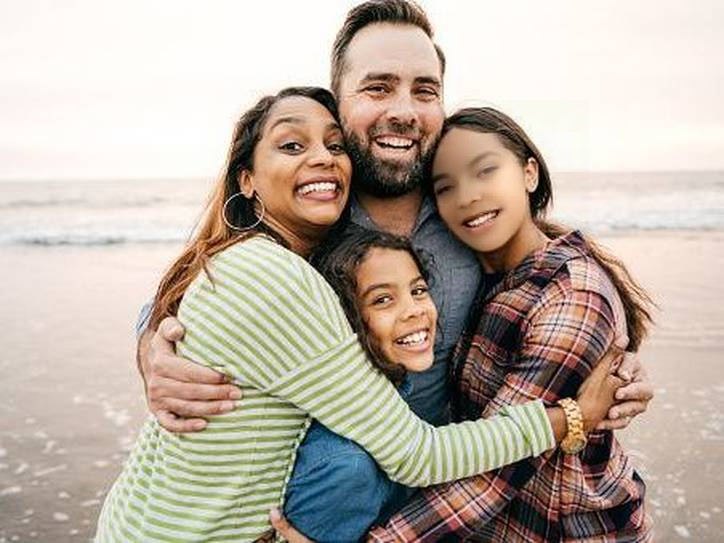

100%|██████████| 2/2 [00:00<00:00, 2998.07it/s]

=> Detecting faces in video: "source_image.jpg..."
=> Extracting sequences from detections in video: "source_image.jpg"...
=> Cropping image sequences from image: "source_image.jpg"...
=> Computing face poses for video: "source_image_seq00.jpg"...


100%|██████████| 1/1 [00:00<00:00,  9.43batches/s]
=> Computing face landmarks for video: "source_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.36batches/s]
=> Computing face segmentation for video: "source_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.78batches/s]

  0%|          | 0/1 [00:00<?, ?frames/s]


=> Detecting faces in video: "target_image.jpg..."


100%|██████████| 2/2 [00:00<00:00, 4642.28it/s]

=> Extracting sequences from detections in video: "target_image.jpg"...
=> Cropping image sequences from image: "target_image.jpg"...
=> Computing face poses for video: "target_image_seq00.jpg"...


100%|██████████| 1/1 [00:00<00:00, 10.16batches/s]
=> Computing face landmarks for video: "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  6.15batches/s]
=> Computing face segmentation for video: "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.95batches/s]
=> Face swapping: "source_image_seq00.jpg" -> "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:01<00:00,  1.51s/batches]


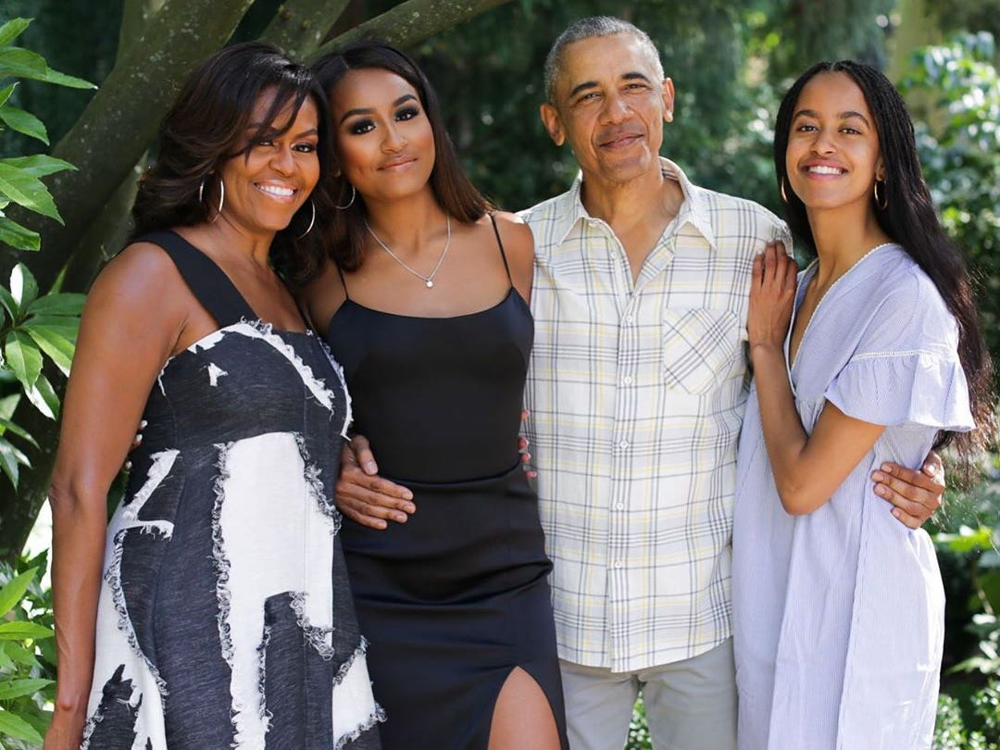

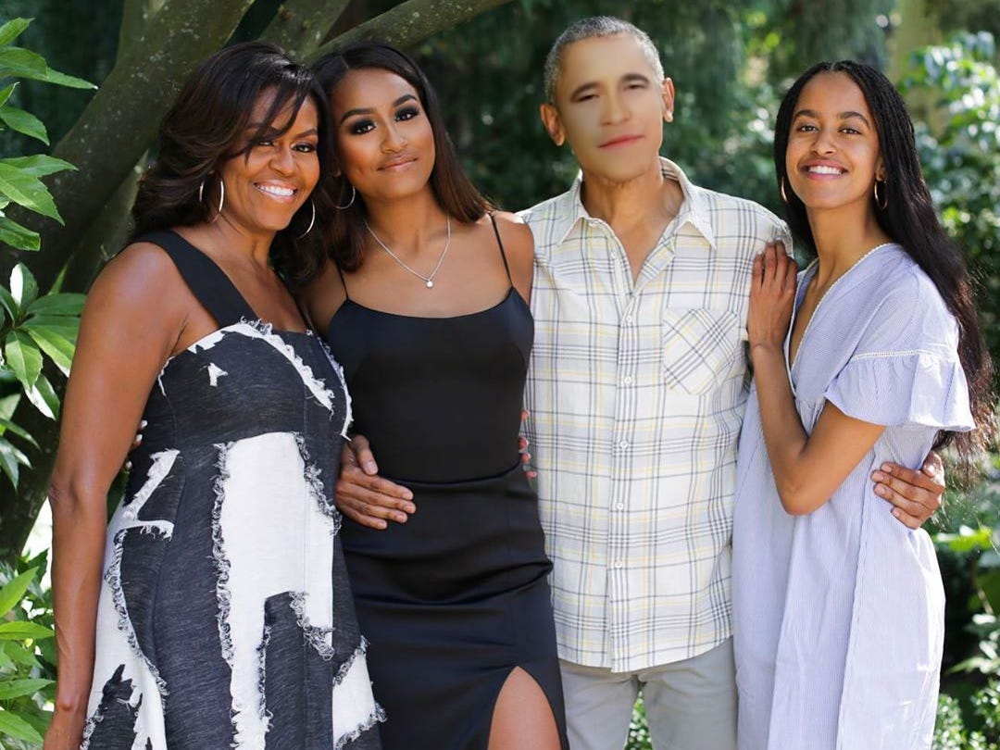

100%|██████████| 2/2 [00:00<00:00, 1561.54it/s]

=> Detecting faces in video: "source_image.jpg..."
=> Extracting sequences from detections in video: "source_image.jpg"...
=> Cropping image sequences from image: "source_image.jpg"...
=> Computing face poses for video: "source_image_seq00.jpg"...


100%|██████████| 1/1 [00:00<00:00,  9.75batches/s]
=> Computing face landmarks for video: "source_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.39batches/s]
=> Computing face segmentation for video: "source_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.71batches/s]

  0%|          | 0/1 [00:00<?, ?frames/s]


=> Detecting faces in video: "target_image.jpg..."


100%|██████████| 2/2 [00:00<00:00, 1926.64it/s]

=> Extracting sequences from detections in video: "target_image.jpg"...
=> Cropping image sequences from image: "target_image.jpg"...
=> Computing face poses for video: "target_image_seq00.jpg"...


100%|██████████| 1/1 [00:00<00:00, 10.44batches/s]
=> Computing face landmarks for video: "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  6.12batches/s]
=> Computing face segmentation for video: "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.98batches/s]
=> Face swapping: "source_image_seq00.jpg" -> "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:01<00:00,  1.46s/batches]


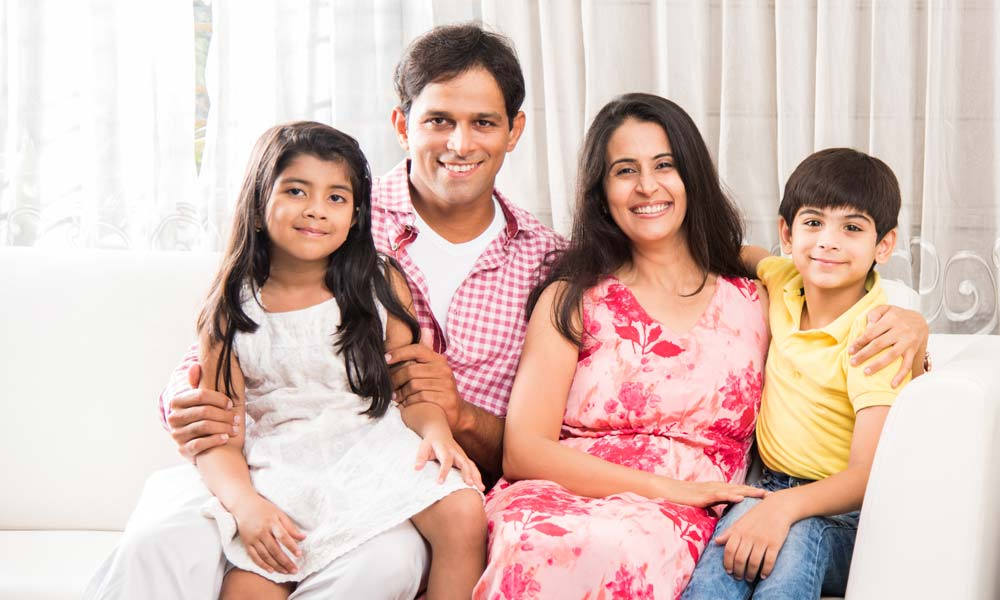

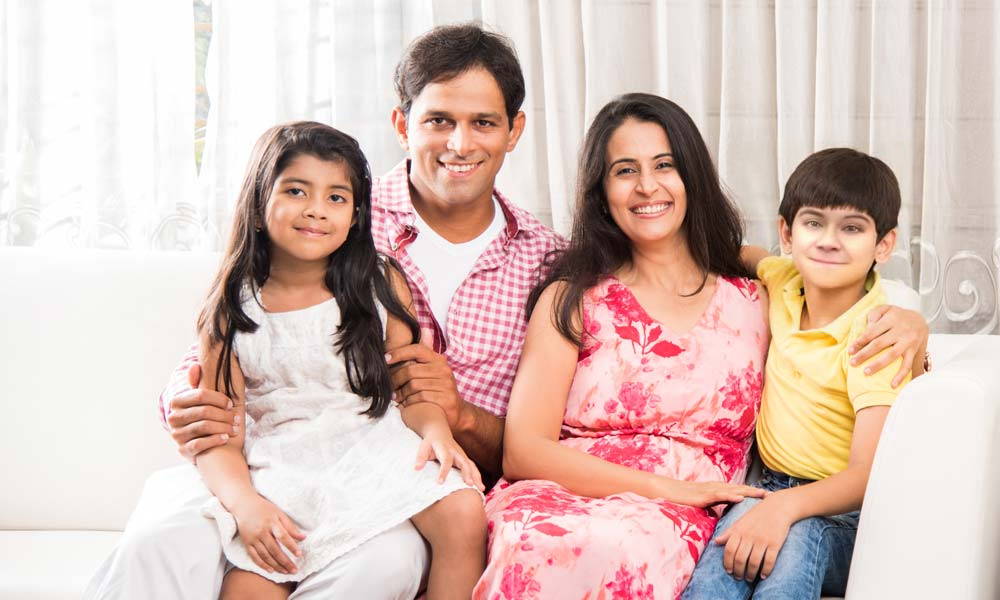

100%|██████████| 2/2 [00:00<00:00, 1190.21it/s]

=> Detecting faces in video: "source_image.jpg..."
=> Extracting sequences from detections in video: "source_image.jpg"...
=> Cropping image sequences from image: "source_image.jpg"...
=> Computing face poses for video: "source_image_seq00.jpg"...


100%|██████████| 1/1 [00:00<00:00,  9.68batches/s]
=> Computing face landmarks for video: "source_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.61batches/s]
=> Computing face segmentation for video: "source_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.70batches/s]

  0%|          | 0/1 [00:00<?, ?frames/s]


=> Detecting faces in video: "target_image.jpg..."


100%|██████████| 2/2 [00:00<00:00, 1003.78it/s]

=> Extracting sequences from detections in video: "target_image.jpg"...
=> Cropping image sequences from image: "target_image.jpg"...


=> Computing face poses for video: "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  9.90batches/s]
=> Computing face landmarks for video: "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.58batches/s]
=> Computing face segmentation for video: "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.83batches/s]
=> Face swapping: "source_image_seq00.jpg" -> "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:01<00:00,  1.49s/batches]


100%|██████████| 2/2 [00:00<00:00, 1326.89it/s]

=> Detecting faces in video: "source_image.jpg..."
=> Extracting sequences from detections in video: "source_image.jpg"...
=> Cropping image sequences from image: "source_image.jpg"...
=> Computing face poses for video: "source_image_seq00.jpg"...


100%|██████████| 1/1 [00:00<00:00,  9.92batches/s]
=> Computing face landmarks for video: "source_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  6.00batches/s]
=> Computing face segmentation for video: "source_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  6.10batches/s]

  0%|          | 0/1 [00:00<?, ?frames/s]


=> Detecting faces in video: "target_image.jpg..."


100%|██████████| 2/2 [00:00<00:00, 2282.61it/s]

=> Extracting sequences from detections in video: "target_image.jpg"...
=> Cropping image sequences from image: "target_image.jpg"...
=> Computing face poses for video: "target_image_seq00.jpg"...


100%|██████████| 1/1 [00:00<00:00, 10.08batches/s]
=> Computing face landmarks for video: "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.70batches/s]
=> Computing face segmentation for video: "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.99batches/s]
=> Face swapping: "source_image_seq00.jpg" -> "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:01<00:00,  1.46s/batches]


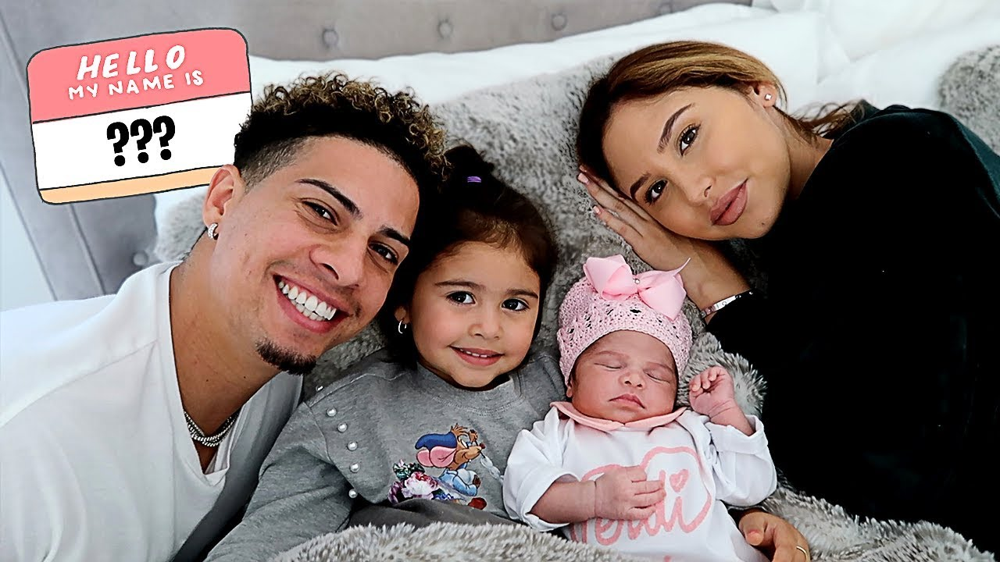

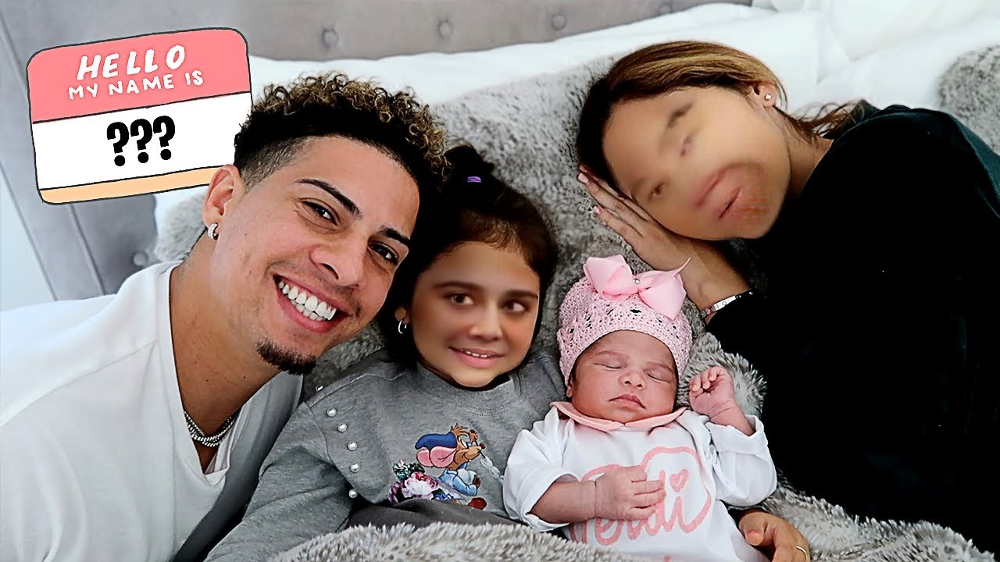

100%|██████████| 2/2 [00:00<00:00, 713.50it/s]

=> Detecting faces in video: "source_image.jpg..."
=> Extracting sequences from detections in video: "source_image.jpg"...
=> Cropping image sequences from image: "source_image.jpg"...
=> Computing face poses for video: "source_image_seq00.jpg"...


100%|██████████| 1/1 [00:00<00:00, 10.11batches/s]
=> Computing face landmarks for video: "source_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  6.25batches/s]
=> Computing face segmentation for video: "source_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.94batches/s]

  0%|          | 0/1 [00:00<?, ?frames/s]


=> Detecting faces in video: "target_image.jpg..."


100%|██████████| 2/2 [00:00<00:00, 2778.60it/s]

=> Extracting sequences from detections in video: "target_image.jpg"...
=> Cropping image sequences from image: "target_image.jpg"...
=> Computing face poses for video: "target_image_seq00.jpg"...


100%|██████████| 1/1 [00:00<00:00, 10.00batches/s]
=> Computing face landmarks for video: "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  6.23batches/s]
=> Computing face segmentation for video: "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.92batches/s]
=> Face swapping: "source_image_seq00.jpg" -> "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:01<00:00,  1.53s/batches]


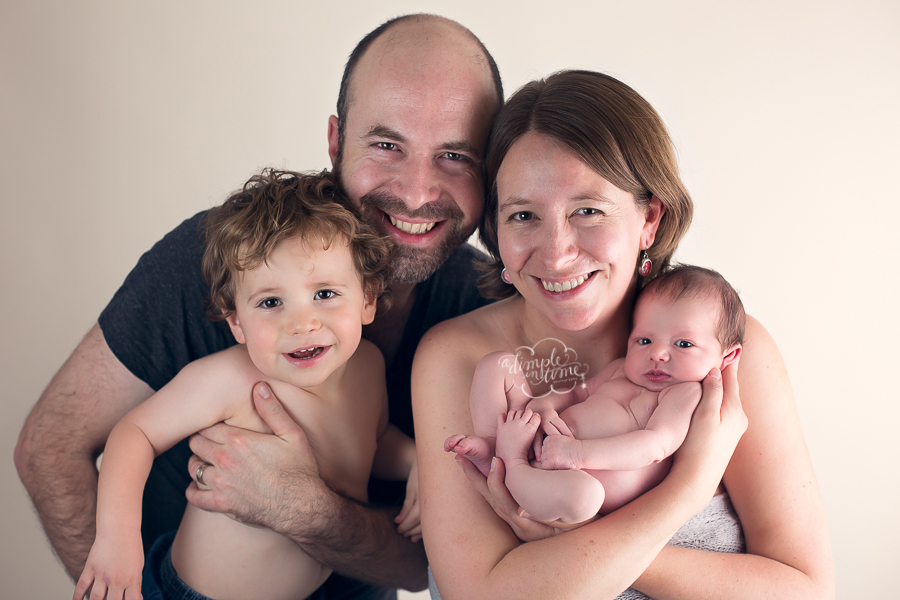

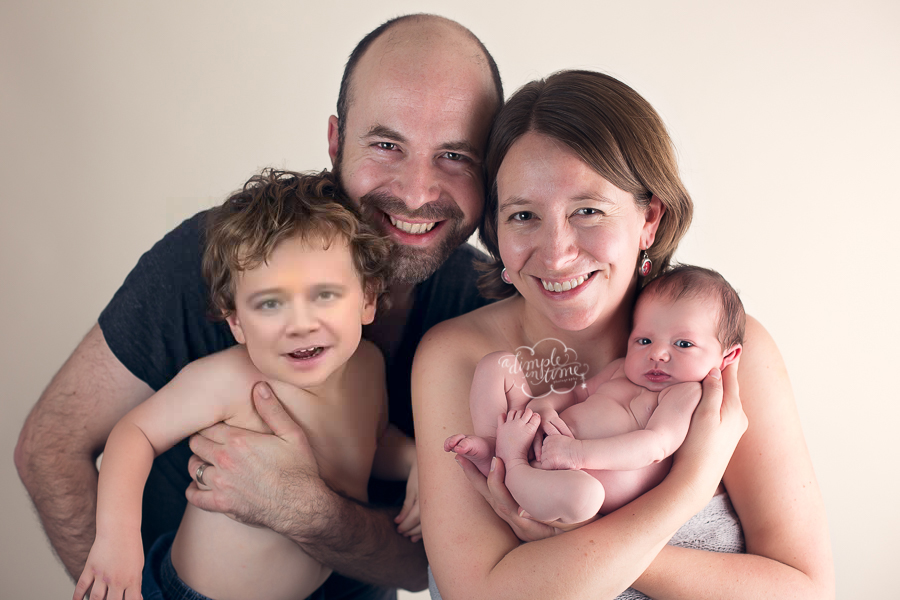

100%|██████████| 2/2 [00:00<00:00, 3217.72it/s]

=> Detecting faces in video: "source_image.jpg..."
=> Extracting sequences from detections in video: "source_image.jpg"...
=> Cropping image sequences from image: "source_image.jpg"...
=> Computing face poses for video: "source_image_seq00.jpg"...


100%|██████████| 1/1 [00:00<00:00,  9.80batches/s]
=> Computing face landmarks for video: "source_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.77batches/s]
=> Computing face segmentation for video: "source_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.67batches/s]

  0%|          | 0/1 [00:00<?, ?frames/s]


=> Detecting faces in video: "target_image.jpg..."


100%|██████████| 2/2 [00:00<00:00, 3344.74it/s]

=> Extracting sequences from detections in video: "target_image.jpg"...
=> Cropping image sequences from image: "target_image.jpg"...
=> Computing face poses for video: "target_image_seq00.jpg"...


100%|██████████| 1/1 [00:00<00:00,  9.64batches/s]
=> Computing face poses for video: "target_image_seq01.jpg"...
100%|██████████| 1/1 [00:00<00:00,  9.20batches/s]
=> Computing face landmarks for video: "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  6.00batches/s]
=> Computing face landmarks for video: "target_image_seq01.jpg"...
100%|██████████| 1/1 [00:00<00:00,  6.11batches/s]
=> Computing face segmentation for video: "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  6.08batches/s]
=> Computing face segmentation for video: "target_image_seq01.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.96batches/s]
=> Face swapping: "source_image_seq00.jpg" -> "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:01<00:00,  1.49s/batches]


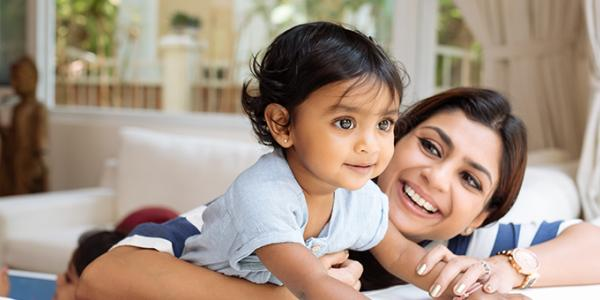

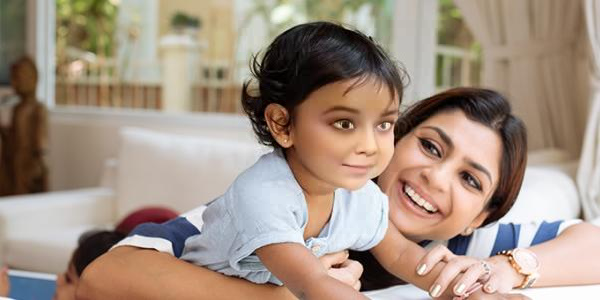

100%|██████████| 2/2 [00:00<00:00, 1065.90it/s]

=> Detecting faces in video: "source_image.jpg..."
=> Extracting sequences from detections in video: "source_image.jpg"...
=> Cropping image sequences from image: "source_image.jpg"...
=> Computing face poses for video: "source_image_seq00.jpg"...


100%|██████████| 1/1 [00:00<00:00,  9.98batches/s]
=> Computing face landmarks for video: "source_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  6.15batches/s]
=> Computing face segmentation for video: "source_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.80batches/s]

  0%|          | 0/1 [00:00<?, ?frames/s]


=> Detecting faces in video: "target_image.jpg..."


100%|██████████| 2/2 [00:00<00:00, 4834.93it/s]

=> Extracting sequences from detections in video: "target_image.jpg"...
=> Cropping image sequences from image: "target_image.jpg"...
=> Computing face poses for video: "target_image_seq00.jpg"...


100%|██████████| 1/1 [00:00<00:00, 10.20batches/s]
=> Computing face poses for video: "target_image_seq01.jpg"...
100%|██████████| 1/1 [00:00<00:00, 10.10batches/s]
=> Computing face landmarks for video: "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  6.11batches/s]
=> Computing face landmarks for video: "target_image_seq01.jpg"...
100%|██████████| 1/1 [00:00<00:00,  6.17batches/s]
=> Computing face segmentation for video: "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:00<00:00,  5.95batches/s]
=> Computing face segmentation for video: "target_image_seq01.jpg"...
100%|██████████| 1/1 [00:00<00:00,  6.26batches/s]
=> Face swapping: "source_image_seq00.jpg" -> "target_image_seq00.jpg"...
100%|██████████| 1/1 [00:01<00:00,  1.46s/batches]


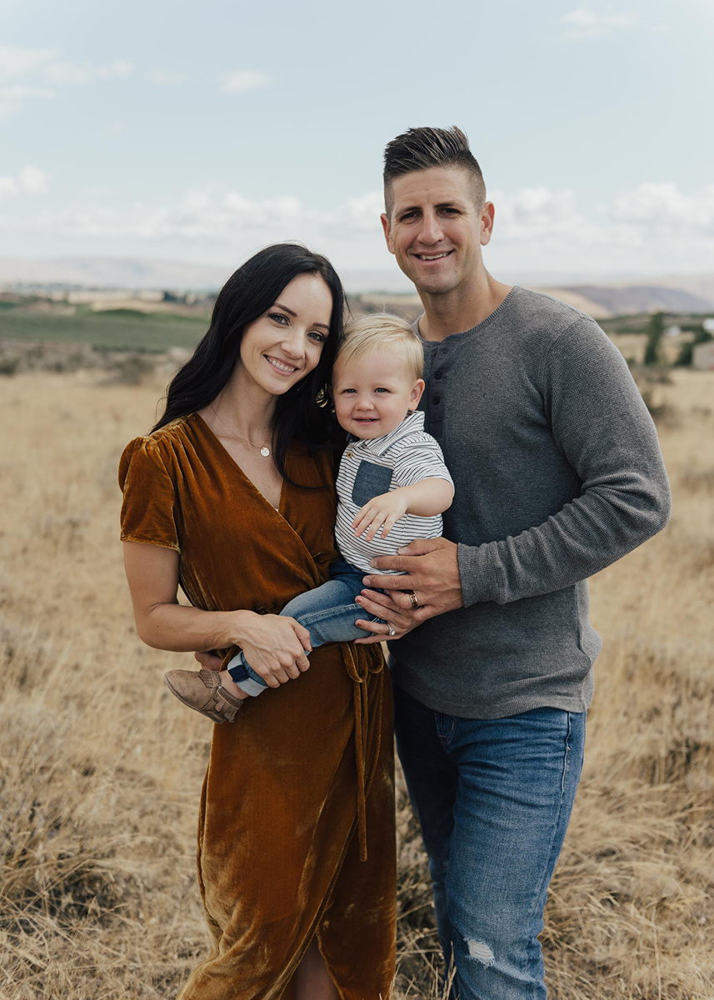

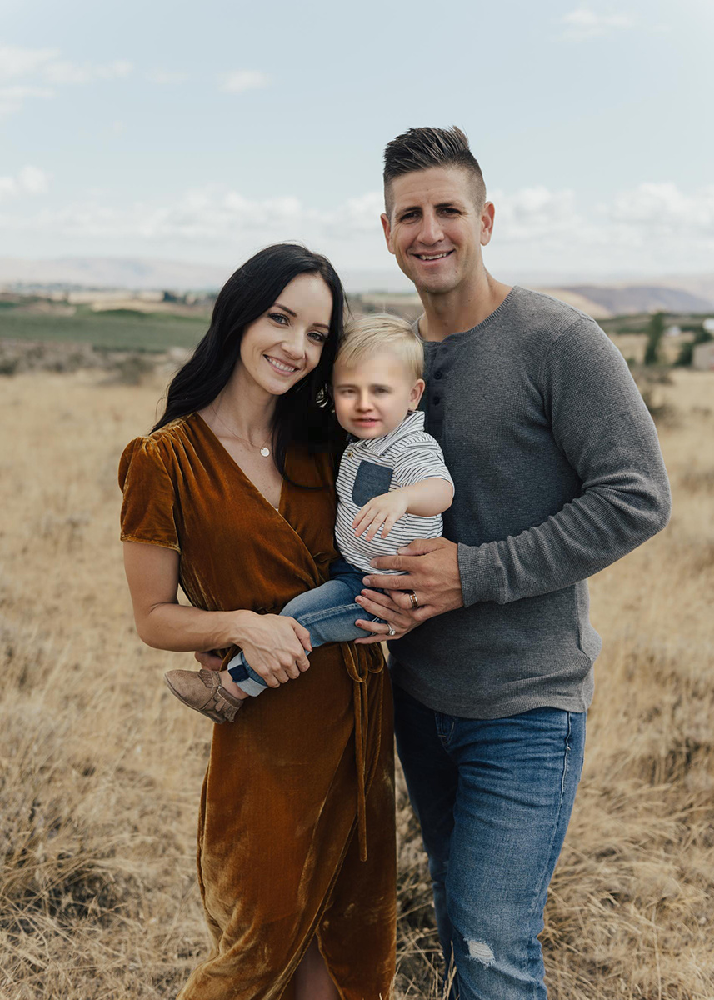

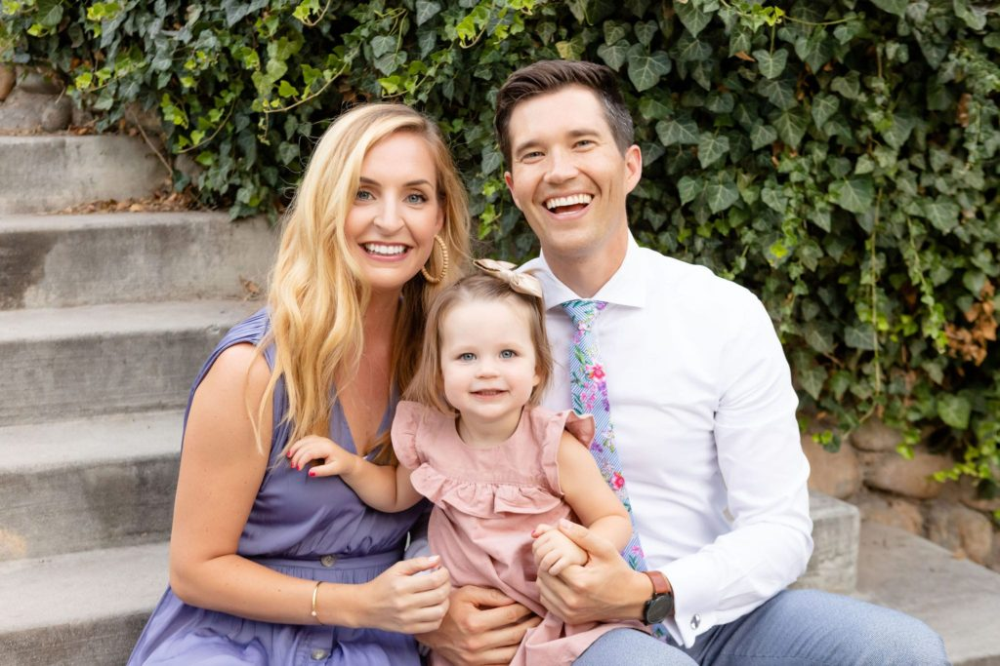

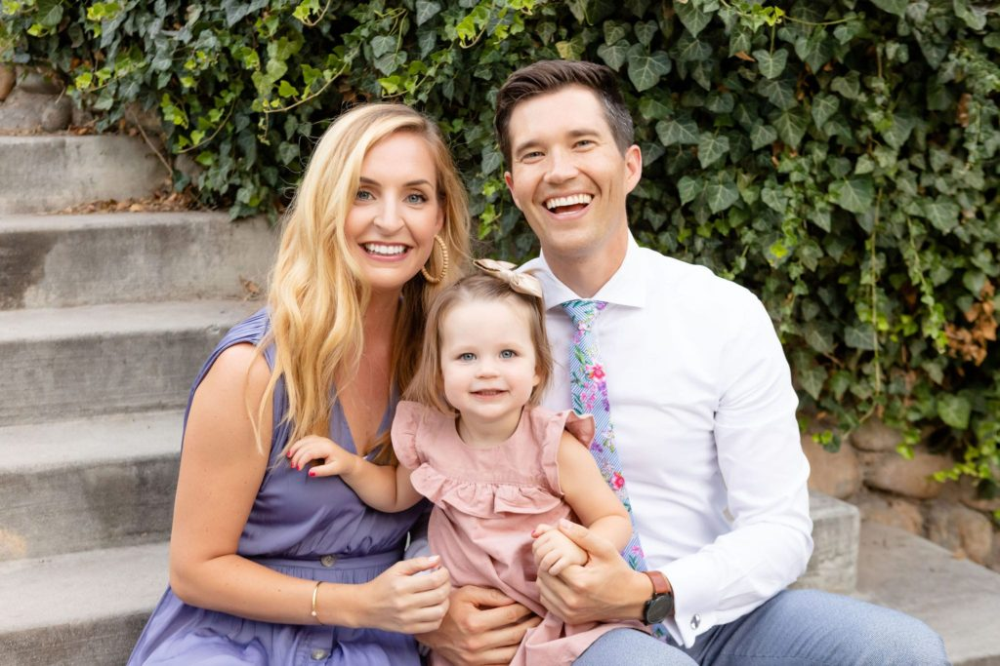

In [10]:
photo_list = os.listdir(test_photo_dir)

for photoName in photo_list:
  testImagePath = test_photo_dir + photoName
  testImage = cv2.imread(testImagePath)
  
  newImage = testImage.copy()
  newImageRecolored = cv2.cvtColor(newImage, cv2.COLOR_BGR2RGB)

  # Receives RGB numpy image (HxWxC) and
  # returns (x_center, y_center, width, height, prob) tuples. 
  bboxes = face_detector.predict(newImageRecolored, thresh = thresh)

  croppedFaces = []

  #Set padding pixels for each photo to improve age detection algorithm
  padding = 50

  #Collect image width and height as maximums for bounding box x and y-coordinates
  imageWidth = int(newImage.shape[1])
  imageHeight = int(newImage.shape[0])

  #Create a list for the adjusted face bounding boxes
  faceBoundingBoxes = []

  for box in bboxes:
    # Extract x and y coordinates
    xc, yc, wi, he, p = box
    x1 = max(int(xc - wi//2 - padding),0)
    x2 = min(int(xc + wi//2 + padding), imageWidth - 1)
    x2 -= (x2-x1)%2
    y1 = max(int(yc - he//2 - padding), 0)
    y2 = min(int(yc + he//2 + padding), imageHeight - 1)
    y2 -= (y2-y1)%2

    paddedBox = [x1, x2, y1, y2]

    faceBoundingBoxes.append(paddedBox)

    #Add cropped face to list
    croppedFace = newImage[y1:y2, x1:x2]
    croppedFaces.append(croppedFace)

  #Create a list for the swapped faces
  swappedFaces = []

  for face in croppedFaces:
    # collect age and gender of face
    age, gender = get_age_and_gender(face)

    # Generate swapped face
    swapped_face = swap_face(face, (age,gender))

    # Add swapped face to new list of faces
    swappedFaces.append(swapped_face)

  #TEST CODE TO ILLUSTRATE SWAPPING CODE ONLY
  # for face in croppedFaces:
  #   swapped_face = cv2.cvtColor(face, cv2.COLOR_BGR2RGB)
  #   swappedFaces.append(swapped_face)
  
  #Combine the faceBoundingBoxes and swappedFaces list to identify swappings to perform
  swappingsToDo = list(zip(faceBoundingBoxes,swappedFaces))

  for swapItem in swappingsToDo:
    faceBoundingBox, replacementFace = swapItem
    x1, x2, y1, y2 = faceBoundingBox
    # print ('x1 = '+ str(x1) + ', x2 = ' + str(x2) + ', y1 = '+ str(y1) + ', y2 = ' + str(y2))
    # print( 'x2-x1 = ' + str(x2-x1) + ', y2-y1 = ' +str(y2-y1))
    # print(newImage.shape)
    # print(replacementFace.shape)

  
    newImage[y1:y2, x1:x2] = replacementFace[0:y2-y1, 0:x2-x1]
    # The problem here is that replacement image is one pixel too small if x2-x1 is odd, not a problem if it is even,
    # I don't know what is causing this since we generate the replacement image...

  cv2_imshow(testImage)
  cv2_imshow(newImage)